In [31]:
import numpy as np
from numpy import zeros, ones, asarray
from numpy.random import randn, randint
from keras.optimizers import Adam
from keras.utils import plot_model
from keras.models import Model, load_model
from keras.layers import Input, Dense, Reshape, Flatten, Conv2D, Conv2DTranspose
from keras.layers import LeakyReLU, ReLU, Dropout, Embedding, Concatenate
from matplotlib import pyplot as plt
import h5py
import cv2
import copy

Data Preprocessing

load dataset:
- only use training set

In [2]:
with h5py.File('dataset_ts_light_version.hdf5', 'r') as f:
    # Showing all keys in the HDF5 binary file
    print(list(f.keys()))

    x_train = f['x_train']  
    y_train = f['y_train']  
    x_train = np.array(x_train)
    y_train = np.array(y_train)

print(x_train.shape)
print(y_train.shape)


['x_test', 'x_train', 'x_validation', 'y_test', 'y_train', 'y_validation']
(90601, 48, 48, 3)
(90601,)


21


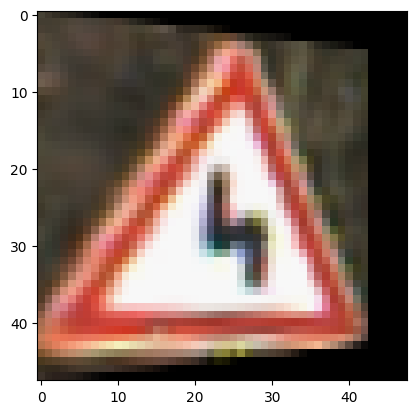

In [3]:
magic_Num = randint(0, len(x_train) -1)
imgplot = plt.imshow(x_train[magic_Num]/255)
print(y_train[magic_Num])
plt.show()

- filter out images that are too dark
- resize to 64 x 64

In [4]:
train_X_processed= []
train_Y_processed = []
for i in range(x_train.shape[0]):
    image64 = cv2.resize(x_train[i], (64,64), interpolation = cv2.INTER_AREA)
    img  = cv2.cvtColor(image64, cv2.COLOR_RGB2HLS)
    Lchanneld = img[:,:,1]
    lvalueld =cv2.mean(Lchanneld)[0]
    if lvalueld > 50:
        train_X_processed.append(image64)
        train_Y_processed.append(y_train[i])

train_X_processed = np.array(train_X_processed)
train_Y_processed = np.array(train_Y_processed)

print(train_X_processed.shape)
print(train_Y_processed.shape)

(71489, 64, 64, 3)
(71489,)


In [4]:
np.save('trainX_64_filtered.npy', train_X_processed)
np.save('trainY_64_filtered.npy', train_Y_processed)

31


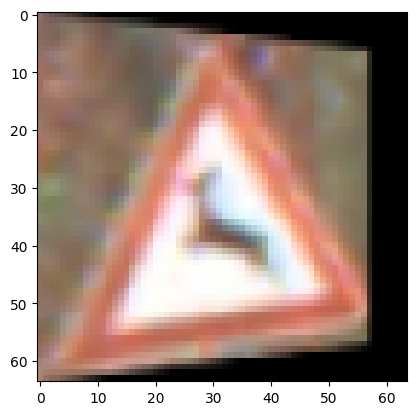

In [5]:
magic_Num = randint(0, len(train_X_processed) -1)
imgplot = plt.imshow(train_X_processed[magic_Num]/255)
print(train_Y_processed[magic_Num])
plt.show()

we will be using conditional GAN to generate traffic signs with 43 classes.

a GAN consist of two component:
- generator: an Upsampling part which will generate an image from noise sampled from normal distribution
- discriminator: an Downsampling part which will do a binary classification on whether the input image is real or fake

a conditional GAN will add an embeded channel to the input of both the generator and discriminator which contains information on what class of traffic signs the GAN will generate

the main goal of a generator is to generate an image that is real enough to fool the discriminator into classifying a generated image is real
while the main goal of discriminator is to classify which image is real or fake is accurate as possible. 

Keras Functional API will be used instead of the sequencial model due to multiple input to the neural network

Generator Implementation

In [2]:
def Generator_Func(dLatent, nClass):
    input_label = Input(shape=(1,))
    embedded_label = Embedding(nClass, 100)(input_label)
    embedded_label = Dense(4*4)(embedded_label)
    embedded_label = Reshape((4, 4, 1))(embedded_label)

    input_noise = Input(shape=(dLatent,))
    noise_layer = Dense(1024*4*4)(input_noise)
    noise_layer = LeakyReLU(alpha=0.2)(noise_layer)
    noise_layer = Reshape((4, 4, 1024))(noise_layer)

    merge = Concatenate()([noise_layer, embedded_label])

    merge = Conv2DTranspose(512, (4,4), strides=(2,2), padding='same')(merge)
    merge = ReLU()(merge)

    merge = Conv2DTranspose(256, (4,4), strides=(2,2), padding='same')(merge)
    merge = ReLU()(merge)

    merge = Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(merge)
    merge = ReLU()(merge)

    merge = Conv2DTranspose(64, (4,4), strides=(2,2), padding='same')(merge)
    merge = ReLU()(merge)

    output = Conv2D(3, (8,8), activation='tanh', padding='same')(merge)
    model = Model([input_noise, input_label], output)

    return model

In [32]:
model_gen = Generator_Func(100, 43)
print(model_gen.summary())

Model: "model_18"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_26 (InputLayer)          [(None, 100)]        0           []                               
                                                                                                  
 input_25 (InputLayer)          [(None, 1)]          0           []                               
                                                                                                  
 dense_25 (Dense)               (None, 16384)        1654784     ['input_26[0][0]']               
                                                                                                  
 embedding_12 (Embedding)       (None, 1, 100)       4300        ['input_25[0][0]']               
                                                                                           

In [33]:
plot_model(model_gen, to_file='generator_model.png')

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model/model_to_dot to work.


Discriminator Implementation

In [3]:
def Discriminatior_Func(nClass, lr=0.0002):
    input_label = Input(shape=(1,))
    embedded_label = Embedding(nClass, 50)(input_label)
    embedded_label = Dense(64*64)(embedded_label)
    embedded_label = Reshape((64, 64, 1))(embedded_label)

    input_image = Input(shape=(64,64,3))

    merge = Concatenate()([input_image, embedded_label])

    merge = Conv2D(128, (3,3), strides=(2,2), padding='same')(merge)
    merge = LeakyReLU(alpha=0.2)(merge)

    merge = Conv2D(256, (3,3), strides=(2,2), padding='same')(merge)
    merge = LeakyReLU(alpha=0.2)(merge)

    merge = Conv2D(512, (3,3), strides=(2,2), padding='same')(merge)
    merge = LeakyReLU(alpha=0.2)(merge)

    merge = Conv2D(1024, (3,3), strides=(2,2), padding='same')(merge)
    merge = LeakyReLU(alpha=0.2)(merge)

    merge = Flatten()(merge)
    merge = Dropout(0.4)(merge)

    output = Dense(1, activation='sigmoid')(merge)
    model = Model([input_image, input_label], output)

    optimizer_Adam = Adam(learning_rate=lr, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=optimizer_Adam, metrics=['accuracy'])
    return model

In [9]:
model_dis = Discriminatior_Func(43)
print(model_dis.summary())

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 embedding_1 (Embedding)        (None, 1, 50)        2150        ['input_3[0][0]']                
                                                                                                  
 dense_2 (Dense)                (None, 1, 4096)      208896      ['embedding_1[0][0]']            
                                                                                                  
 input_4 (InputLayer)           [(None, 64, 64, 3)]  0           []                               
                                                                                            

In [ ]:
plot_model(model_dis, to_file='discriminator_model.png')

Conditional GAN Implementation

In [4]:
def CondGan_Func(generatorModel, discriminatorModel, lr=0.0002):
    discriminatorModel.trainable = False # to train discriminator separately and not with CGAN

    generator_input_noise, generator_input_label = generatorModel.input
    generator_output = generatorModel.output

    GAN_output = discriminatorModel([generator_output, generator_input_label])

    model = Model([generator_input_noise, generator_input_label], GAN_output)

    optimizer_Adam = Adam(learning_rate=lr, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=optimizer_Adam, metrics=['accuracy'])

    return model


    


In [11]:
model_GAN = CondGan_Func(model_gen, model_dis)
print(model_GAN.summary())

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 100)]        0           []                               
                                                                                                  
 input_1 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 dense_1 (Dense)                (None, 16384)        1654784     ['input_2[0][0]']                
                                                                                                  
 embedding (Embedding)          (None, 1, 100)       4300        ['input_1[0][0]']                
                                                                                            

In [ ]:
plot_model(model_GAN, to_file='CGAN_model.png')


In [5]:
def getRealDataset():
	trainX, trainY = np.load('trainX_64_filtered.npy'), np.load('trainY_64_filtered.npy')
	X = trainX.astype('float32')
	X = (X - 127.5) / 127.5  

	return X, trainY

In [6]:
def getRealBatch(dataset, nBatch):  
	randomRange = randint(0, dataset[0].shape[0], nBatch)
	X, label = dataset[0][randomRange], dataset[1][randomRange]
	y = ones((nBatch, 1)) 
	return X, y, label


In [7]:
def getNoise(dLatent, nBatch, nClass):
	normD = randn(dLatent * nBatch)
	noise = normD.reshape(nBatch, dLatent)
	label = randint(0, nClass, nBatch)
	return noise, label


In [8]:
def getFakeBatch(Generator, dLatent, nBatch, nClass):
	noise, label = getNoise(dLatent, nBatch, nClass)
	fakeImg = Generator.predict([noise, label], verbose=0)
	y = zeros((nBatch, 1))  
	return fakeImg, y, label

In [9]:

def showResult(path, start):
	model = load_model(path)
	latent_points, labels = getNoise(100, 100, 43)
	labels = asarray([x for _ in range(10) for x in range(start, start + 10)])
	X  = model.predict([latent_points, labels])
	X = (X + 1) / 2.0
	X = (X*255).astype(np.uint8)
	plt.figure(figsize = (20,20))
	def show_plot(examples, n):
		for i in range(n * n):
			plt.subplot(n, n, 1 + i)
			plt.axis('off')
			plt.imshow(examples[i, :, :, :])
		plt.show()
	show_plot(X, 10)

In [10]:
def train(Generator, Discriminator, CGAN, nEpoch, nBatch,dLatent, dataset, nClass, lr=0.0002):
	epochBatch = int(dataset[0].shape[0] / nBatch)
	for i in range(nEpoch):
		d_loss_real_list = []
		d_acc_real_list = []
		d_loss_fake_list =[]
		d_acc_fake_list =[]
		g_loss_list = []
		for j in range(epochBatch):
			
			X_real, y_real, labels_real  = getRealBatch(dataset, int(nBatch/2))
			d_loss_real, d_acc_real = Discriminator.train_on_batch([X_real, labels_real], y_real)
            
			X_fake, y_fake, labels  = getFakeBatch(Generator, dLatent, int(nBatch/2), nClass)
			d_loss_fake, d_acc_fake = Discriminator.train_on_batch([X_fake, labels], y_fake)
            
			z_input, labels_input = getNoise(dLatent, nBatch, nClass)
            
			y_gan = ones((nBatch, 1))
    
			g_loss = CGAN.train_on_batch([z_input, labels_input], y_gan)
			d_loss_real_list.append(d_loss_real)
			d_acc_real_list.append(d_acc_real)
			d_loss_fake_list.append(d_loss_fake)
			d_acc_fake_list.append(d_acc_fake)
			g_loss_list.append(g_loss[0])
			print('Epoch %d/%d, Batch%d/%d, dis_loss_real=%.3f,dis_acc_real=%.3f, dis_loss_fake=%.3f,dis_acc_fake=%.3f, gan_loss=%.3f' %
				(i+1,nEpoch, j+1, epochBatch, d_loss_real,d_acc_real, d_loss_fake,d_acc_fake, g_loss[0]), end='\r')
		print('Epoch %d/%d, Batch%d/%d, av_dis_loss_real=%.3f,av_dis_acc_real=%.3f, av_dis_loss_fake=%.3f,av_dis_acc_fake=%.3f, av_gan_loss=%.3f' %
				(i+1,nEpoch, j+1, epochBatch, sum(d_loss_real_list) / len(d_loss_real_list),
				sum(d_acc_real_list) / len(d_acc_real_list), sum(d_loss_fake_list) / len(d_loss_fake_list),
				sum(d_acc_fake_list) / len(d_acc_fake_list), sum(g_loss_list) / len(g_loss_list)))
		if (i+1) % 10 == 0 and i != 0:
			Generator.save('64_'+str(i + 1) +'epochs'+str(lr)+'batch'+str(nBatch)+'.h5')

hyperparameter testing

In [11]:
dataset = getRealDataset()

In [12]:

def train_Gan(ir, batchnum, epoch=10):
    print('learning rate:' + str(ir)+ '  ' + 'batch size: '+ str(batchnum))
    d_model = Discriminatior_Func(43,lr = ir)
    g_model = Generator_Func(100, 43)
    gan_model = CondGan_Func(g_model, d_model, lr=ir)

    train(g_model, d_model, gan_model,epoch,batchnum,100, dataset, 43, ir)
    showResult('64_10epochs'+str(ir)+'batch'+str(batchnum)+'.h5', 0)

learning rate:0.0002  batch size: 128
Epoch 1/10, Batch558/558, av_dis_loss_real=0.327,av_dis_acc_real=0.844, av_dis_loss_fake=0.318,av_dis_acc_fake=0.922, av_gan_loss=3.670
Epoch 2/10, Batch558/558, av_dis_loss_real=0.364,av_dis_acc_real=0.816, av_dis_loss_fake=0.285,av_dis_acc_fake=0.927, av_gan_loss=2.940
Epoch 3/10, Batch558/558, av_dis_loss_real=0.366,av_dis_acc_real=0.823, av_dis_loss_fake=0.325,av_dis_acc_fake=0.895, av_gan_loss=2.692
Epoch 4/10, Batch558/558, av_dis_loss_real=0.353,av_dis_acc_real=0.834, av_dis_loss_fake=0.332,av_dis_acc_fake=0.873, av_gan_loss=2.778
Epoch 5/10, Batch558/558, av_dis_loss_real=0.439,av_dis_acc_real=0.779, av_dis_loss_fake=0.412,av_dis_acc_fake=0.833, av_gan_loss=2.279
Epoch 6/10, Batch558/558, av_dis_loss_real=0.446,av_dis_acc_real=0.776, av_dis_loss_fake=0.415,av_dis_acc_fake=0.831, av_gan_loss=2.155
Epoch 7/10, Batch558/558, av_dis_loss_real=0.473,av_dis_acc_real=0.756, av_dis_loss_fake=0.436,av_dis_acc_fake=0.815, av_gan_loss=2.048
Epoch 8/10

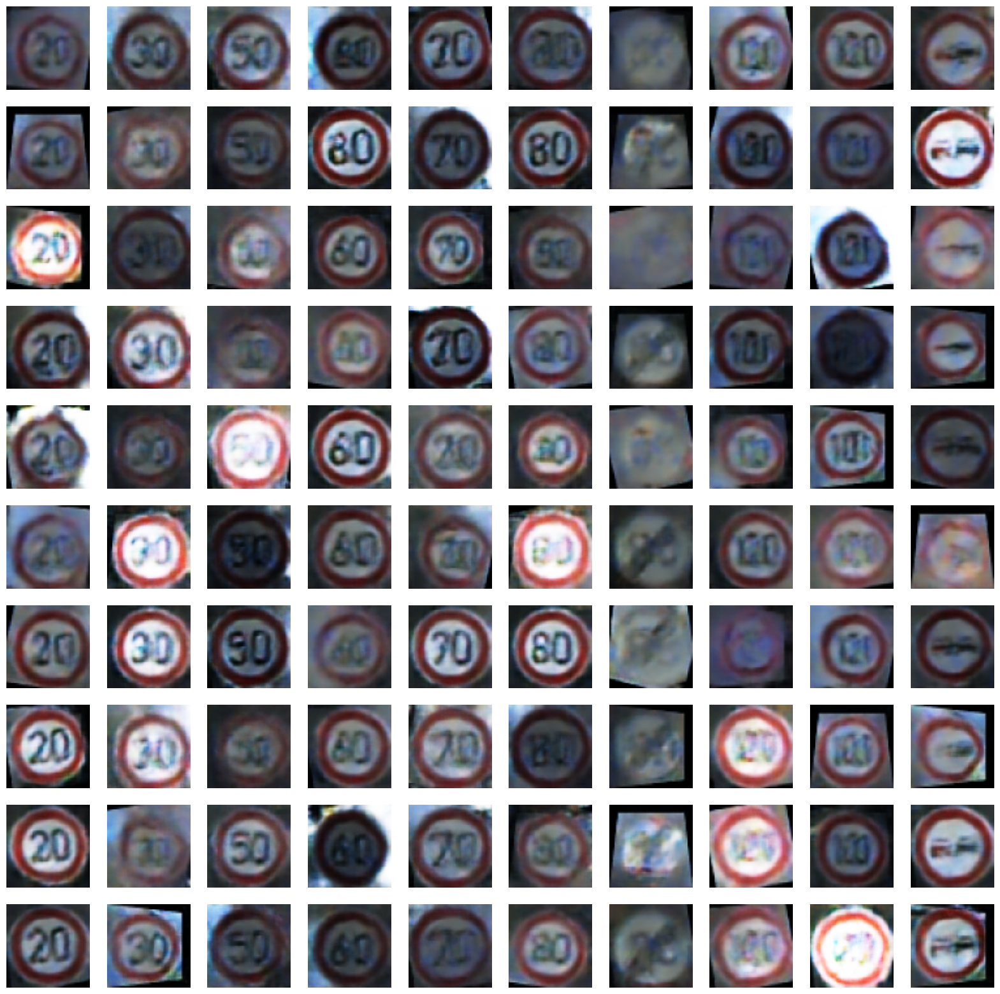

In [20]:
train_Gan(0.0002, 128)

learning rate:0.002  batch size: 128
Epoch 1/10, Batch558/558, av_dis_loss_real=2.579,av_dis_acc_real=0.691, av_dis_loss_fake=0.997,av_dis_acc_fake=0.770, av_gan_loss=7.747
Epoch 2/10, Batch558/558, av_dis_loss_real=0.581,av_dis_acc_real=0.645, av_dis_loss_fake=0.576,av_dis_acc_fake=0.743, av_gan_loss=1.749
Epoch 3/10, Batch558/558, av_dis_loss_real=28211.055,av_dis_acc_real=0.911, av_dis_loss_fake=351834.614,av_dis_acc_fake=0.936, av_gan_loss=175455.981
Epoch 4/10, Batch558/558, av_dis_loss_real=0.287,av_dis_acc_real=1.000, av_dis_loss_fake=0.423,av_dis_acc_fake=1.000, av_gan_loss=75515.533
Epoch 5/10, Batch558/558, av_dis_loss_real=1.967,av_dis_acc_real=1.000, av_dis_loss_fake=0.292,av_dis_acc_fake=1.000, av_gan_loss=87670.578
Epoch 6/10, Batch558/558, av_dis_loss_real=12.194,av_dis_acc_real=1.000, av_dis_loss_fake=0.696,av_dis_acc_fake=1.000, av_gan_loss=75407.189
Epoch 7/10, Batch558/558, av_dis_loss_real=0.000,av_dis_acc_real=1.000, av_dis_loss_fake=0.000,av_dis_acc_fake=1.000, av

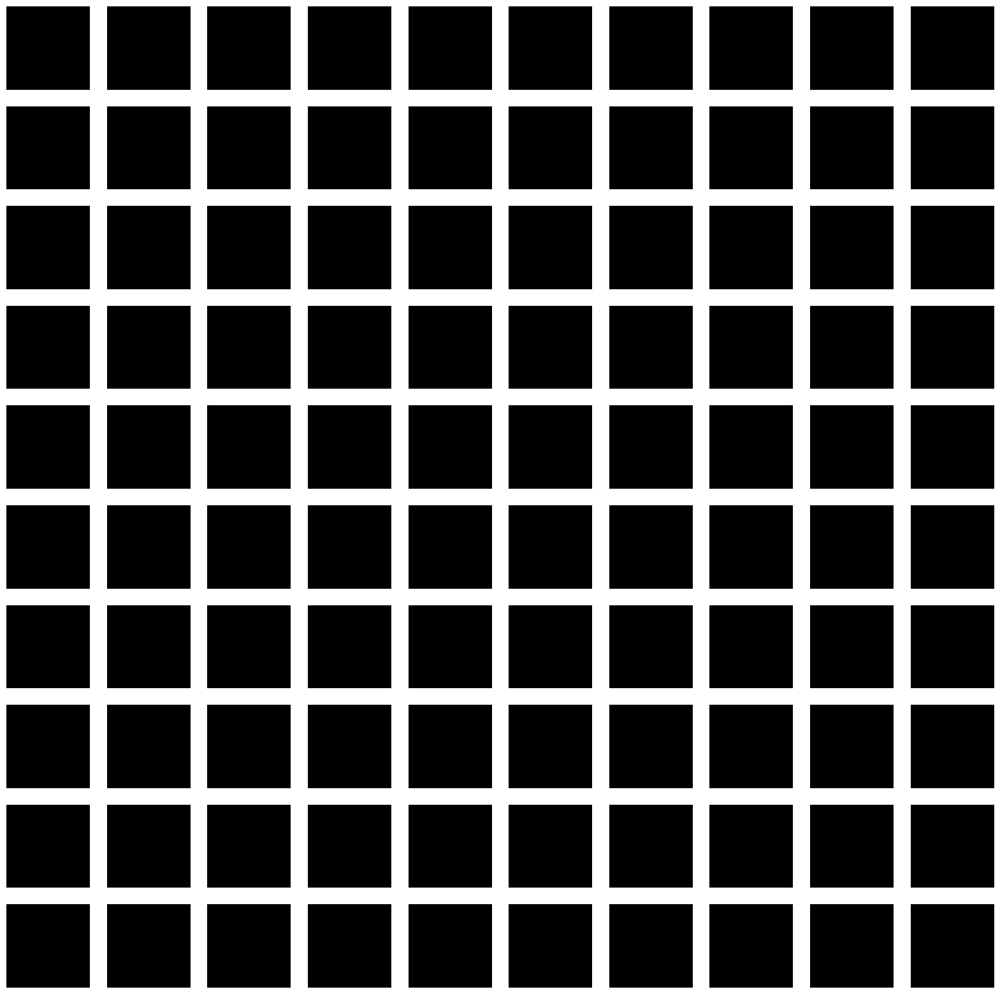

In [13]:
train_Gan(0.002, 128)

learning rate:2e-05  batch size: 128
Epoch 1/10, Batch558/558, av_dis_loss_real=0.256,av_dis_acc_real=0.898, av_dis_loss_fake=0.277,av_dis_acc_fake=0.916, av_gan_loss=2.518
Epoch 2/10, Batch558/558, av_dis_loss_real=0.374,av_dis_acc_real=0.815, av_dis_loss_fake=0.217,av_dis_acc_fake=0.980, av_gan_loss=2.461
Epoch 3/10, Batch558/558, av_dis_loss_real=0.448,av_dis_acc_real=0.773, av_dis_loss_fake=0.287,av_dis_acc_fake=0.949, av_gan_loss=2.044
Epoch 4/10, Batch558/558, av_dis_loss_real=0.441,av_dis_acc_real=0.769, av_dis_loss_fake=0.312,av_dis_acc_fake=0.955, av_gan_loss=1.871
Epoch 5/10, Batch558/558, av_dis_loss_real=0.411,av_dis_acc_real=0.765, av_dis_loss_fake=0.287,av_dis_acc_fake=0.976, av_gan_loss=1.881
Epoch 6/10, Batch558/558, av_dis_loss_real=0.383,av_dis_acc_real=0.792, av_dis_loss_fake=0.243,av_dis_acc_fake=0.974, av_gan_loss=2.186
Epoch 7/10, Batch558/558, av_dis_loss_real=0.357,av_dis_acc_real=0.804, av_dis_loss_fake=0.254,av_dis_acc_fake=0.978, av_gan_loss=2.063
Epoch 8/10,

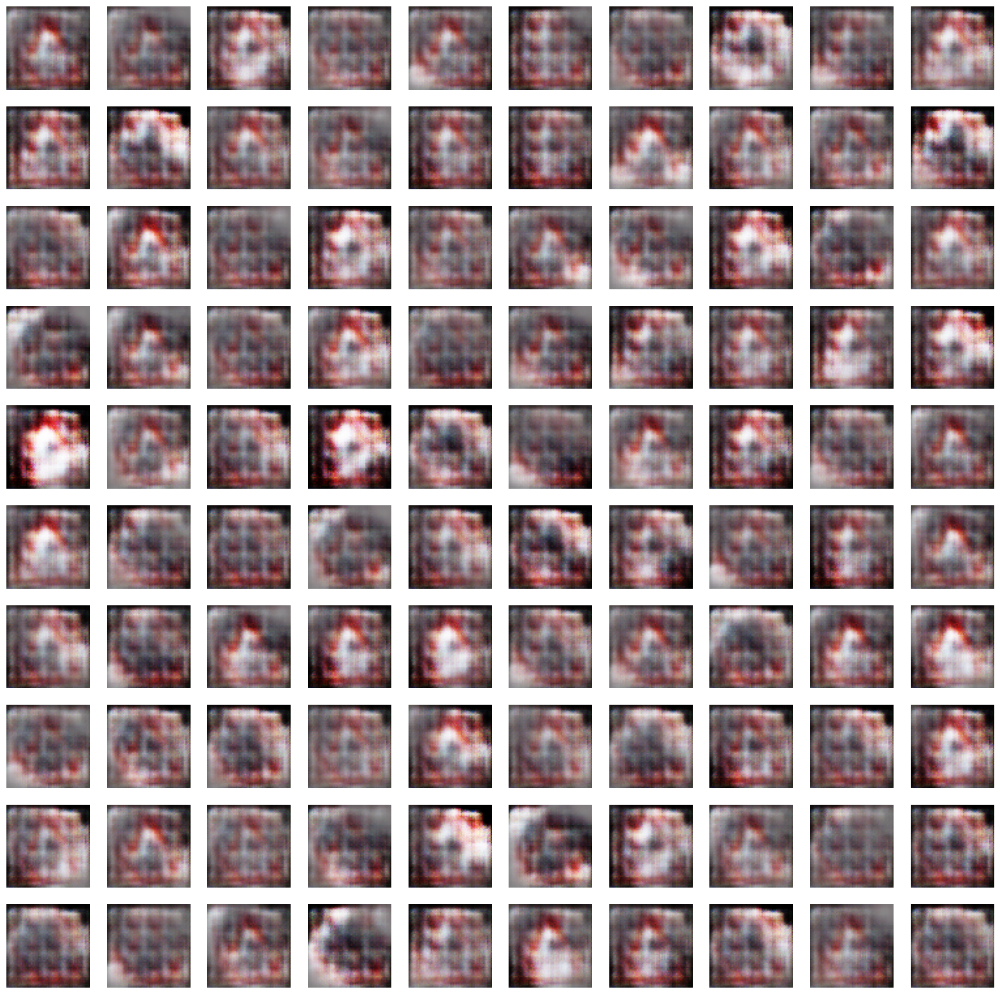

In [15]:
train_Gan(0.00002, 128)

learning rate:0.0002  batch size: 256
Epoch 1/10, Batch279/279, av_dis_loss_real=0.324,av_dis_acc_real=0.874, av_dis_loss_fake=0.350,av_dis_acc_fake=0.927, av_gan_loss=4.422
Epoch 2/10, Batch279/279, av_dis_loss_real=0.381,av_dis_acc_real=0.805, av_dis_loss_fake=0.252,av_dis_acc_fake=0.971, av_gan_loss=2.846
Epoch 3/10, Batch279/279, av_dis_loss_real=0.351,av_dis_acc_real=0.836, av_dis_loss_fake=0.295,av_dis_acc_fake=0.951, av_gan_loss=3.663
Epoch 4/10, Batch279/279, av_dis_loss_real=0.326,av_dis_acc_real=0.853, av_dis_loss_fake=0.229,av_dis_acc_fake=0.950, av_gan_loss=4.205
Epoch 5/10, Batch279/279, av_dis_loss_real=0.319,av_dis_acc_real=0.857, av_dis_loss_fake=0.231,av_dis_acc_fake=0.954, av_gan_loss=4.094
Epoch 6/10, Batch279/279, av_dis_loss_real=0.286,av_dis_acc_real=0.869, av_dis_loss_fake=0.202,av_dis_acc_fake=0.957, av_gan_loss=4.022
Epoch 7/10, Batch279/279, av_dis_loss_real=0.265,av_dis_acc_real=0.884, av_dis_loss_fake=0.201,av_dis_acc_fake=0.942, av_gan_loss=4.092
Epoch 8/10

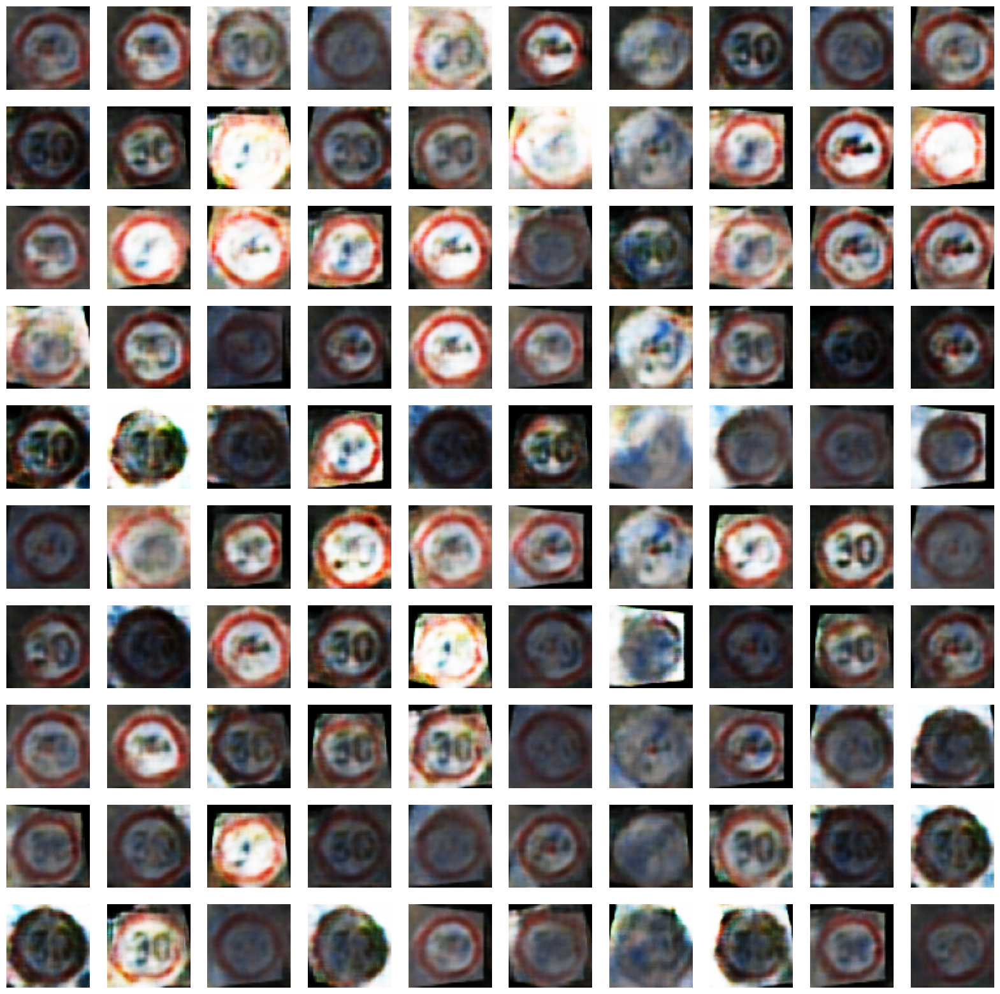

In [16]:
train_Gan(0.0002, 256)

learning rate:0.002  batch size: 256
Epoch 1/10, Batch279/279, av_dis_loss_real=7.208,av_dis_acc_real=0.715, av_dis_loss_fake=11.194,av_dis_acc_fake=0.739, av_gan_loss=13.148
Epoch 2/10, Batch279/279, av_dis_loss_real=0.694,av_dis_acc_real=0.497, av_dis_loss_fake=0.642,av_dis_acc_fake=0.702, av_gan_loss=1.374
Epoch 3/10, Batch279/279, av_dis_loss_real=0.656,av_dis_acc_real=0.523, av_dis_loss_fake=0.648,av_dis_acc_fake=0.683, av_gan_loss=1.132
Epoch 4/10, Batch279/279, av_dis_loss_real=0.610,av_dis_acc_real=0.618, av_dis_loss_fake=0.627,av_dis_acc_fake=0.698, av_gan_loss=1.284
Epoch 5/10, Batch279/279, av_dis_loss_real=0.635,av_dis_acc_real=0.582, av_dis_loss_fake=0.640,av_dis_acc_fake=0.675, av_gan_loss=1.199
Epoch 6/10, Batch279/279, av_dis_loss_real=0.612,av_dis_acc_real=0.601, av_dis_loss_fake=0.608,av_dis_acc_fake=0.720, av_gan_loss=1.413
Epoch 7/10, Batch279/279, av_dis_loss_real=19728.132,av_dis_acc_real=0.825, av_dis_loss_fake=138789.074,av_dis_acc_fake=0.868, av_gan_loss=410500

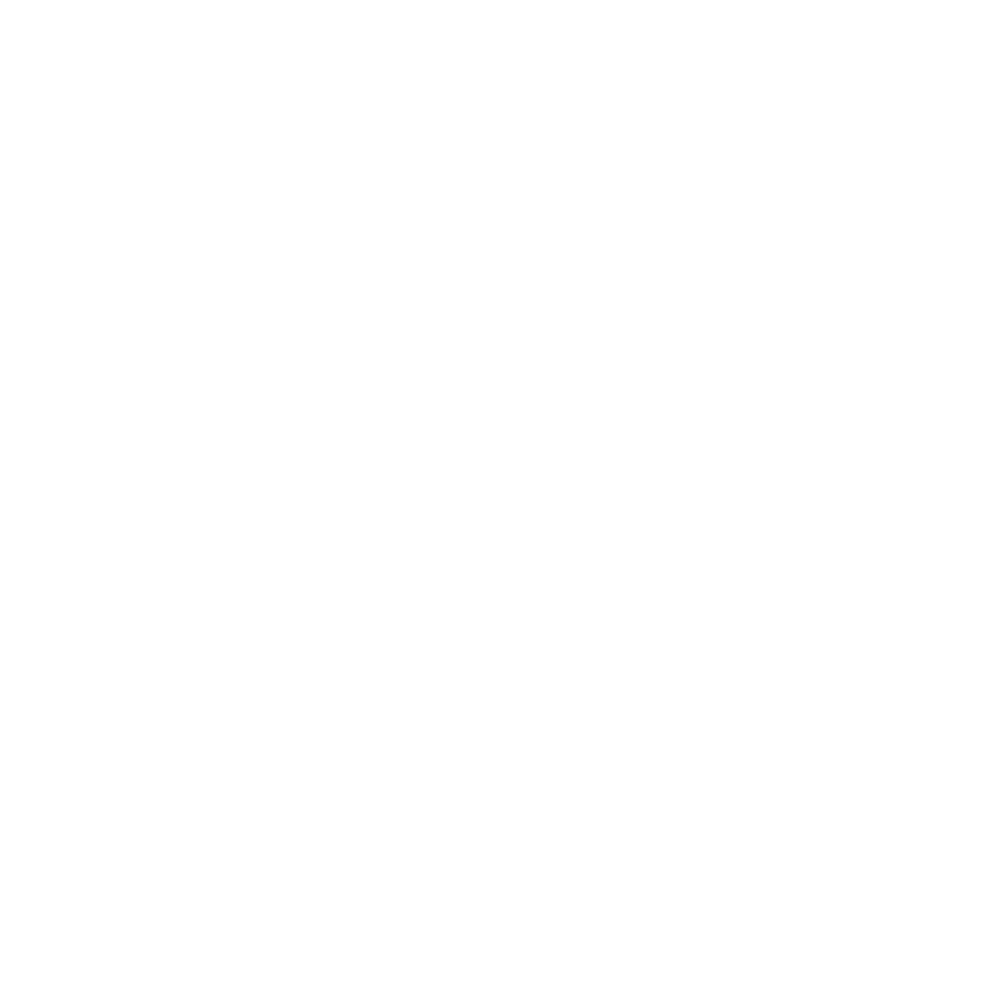

In [17]:
train_Gan(0.002, 256)

learning rate:2e-05  batch size: 256
Epoch 1/10, Batch279/279, av_dis_loss_real=0.264,av_dis_acc_real=0.894, av_dis_loss_fake=0.441,av_dis_acc_fake=0.862, av_gan_loss=1.690
Epoch 2/10, Batch279/279, av_dis_loss_real=0.337,av_dis_acc_real=0.821, av_dis_loss_fake=0.244,av_dis_acc_fake=0.981, av_gan_loss=2.092
Epoch 3/10, Batch279/279, av_dis_loss_real=0.432,av_dis_acc_real=0.779, av_dis_loss_fake=0.291,av_dis_acc_fake=0.957, av_gan_loss=2.186
Epoch 4/10, Batch279/279, av_dis_loss_real=0.459,av_dis_acc_real=0.765, av_dis_loss_fake=0.320,av_dis_acc_fake=0.916, av_gan_loss=2.007
Epoch 5/10, Batch279/279, av_dis_loss_real=0.452,av_dis_acc_real=0.761, av_dis_loss_fake=0.306,av_dis_acc_fake=0.919, av_gan_loss=2.067
Epoch 6/10, Batch279/279, av_dis_loss_real=0.394,av_dis_acc_real=0.792, av_dis_loss_fake=0.320,av_dis_acc_fake=0.959, av_gan_loss=1.843
Epoch 7/10, Batch279/279, av_dis_loss_real=0.423,av_dis_acc_real=0.760, av_dis_loss_fake=0.284,av_dis_acc_fake=0.961, av_gan_loss=1.929
Epoch 8/10,

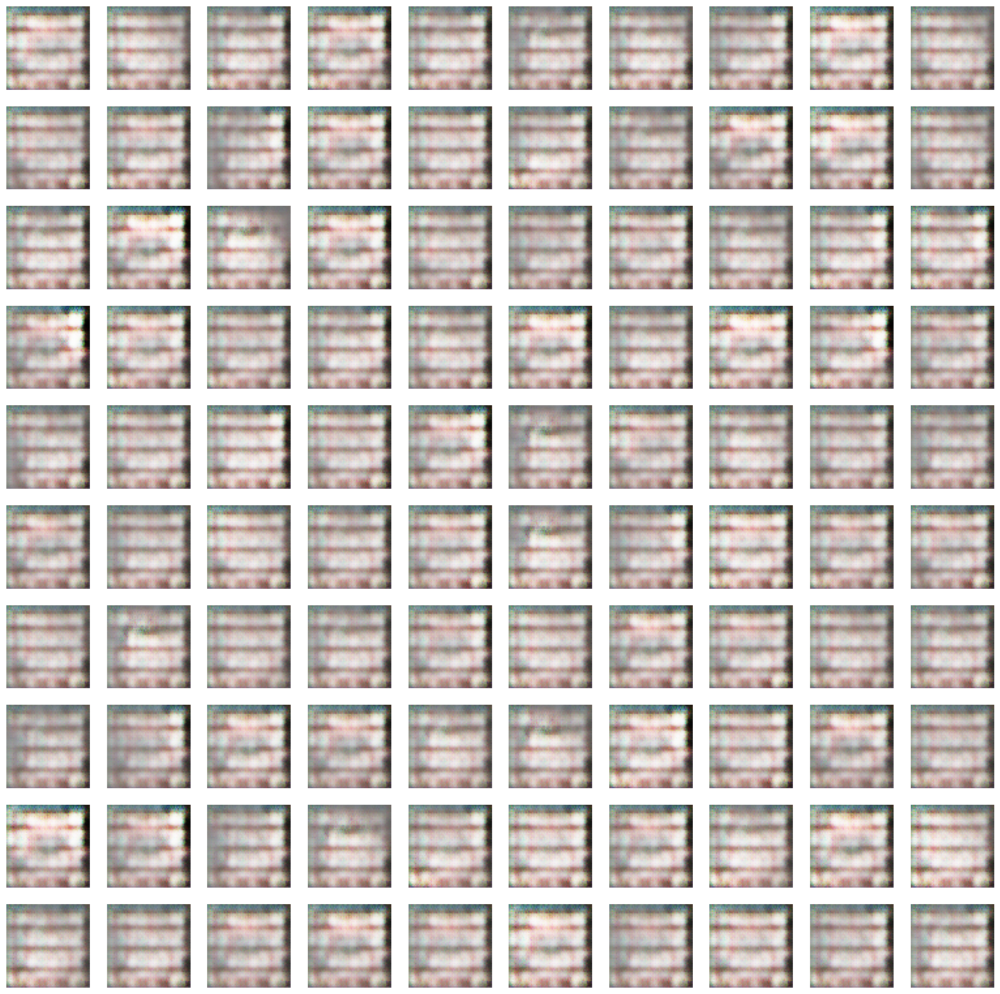

In [18]:
train_Gan(0.00002, 256)

In [ ]:
train_Gan(0.0002, 128, 80)

4/4 [==============================] - 0s 98ms/step


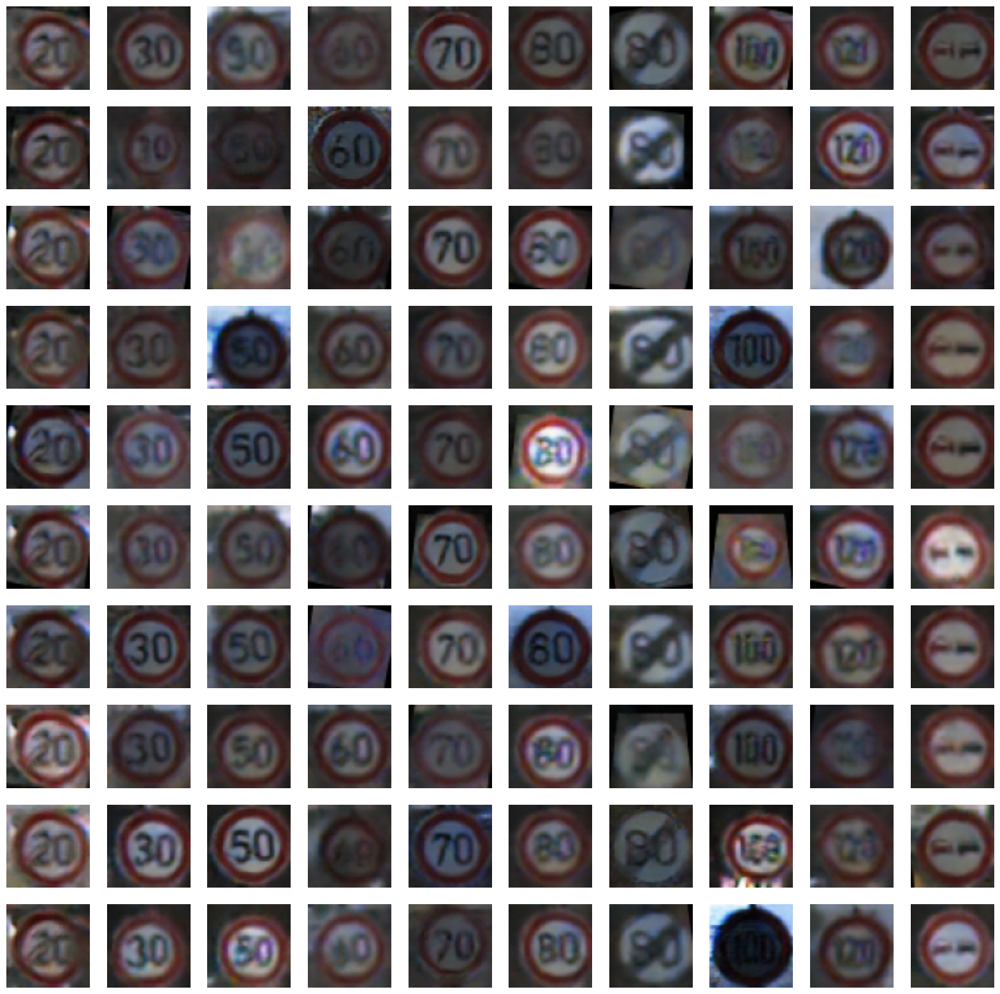

In [26]:
showResult('weights/traffic_signs_64_80epochs.h5', 0)

4/4 [==============================] - 0s 86ms/step


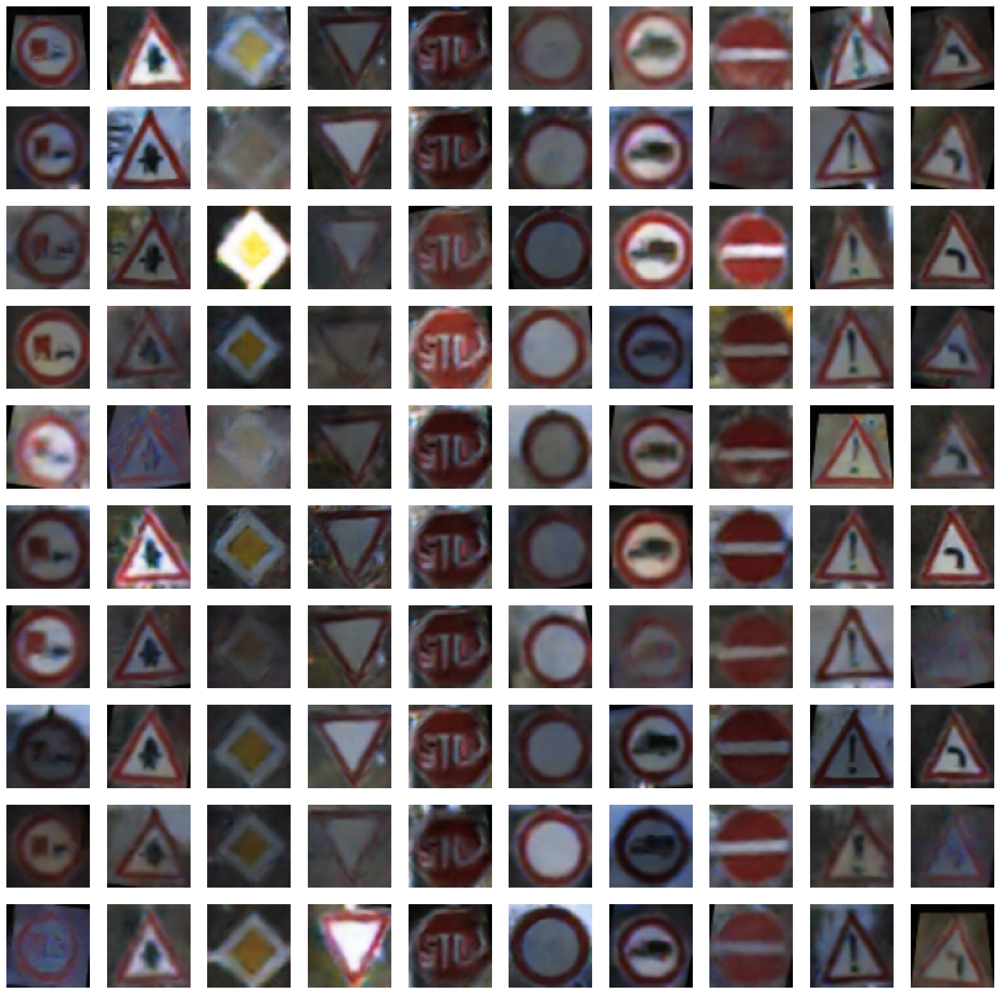

In [27]:
showResult('weights/traffic_signs_64_80epochs.h5', 10)

4/4 [==============================] - 0s 81ms/step


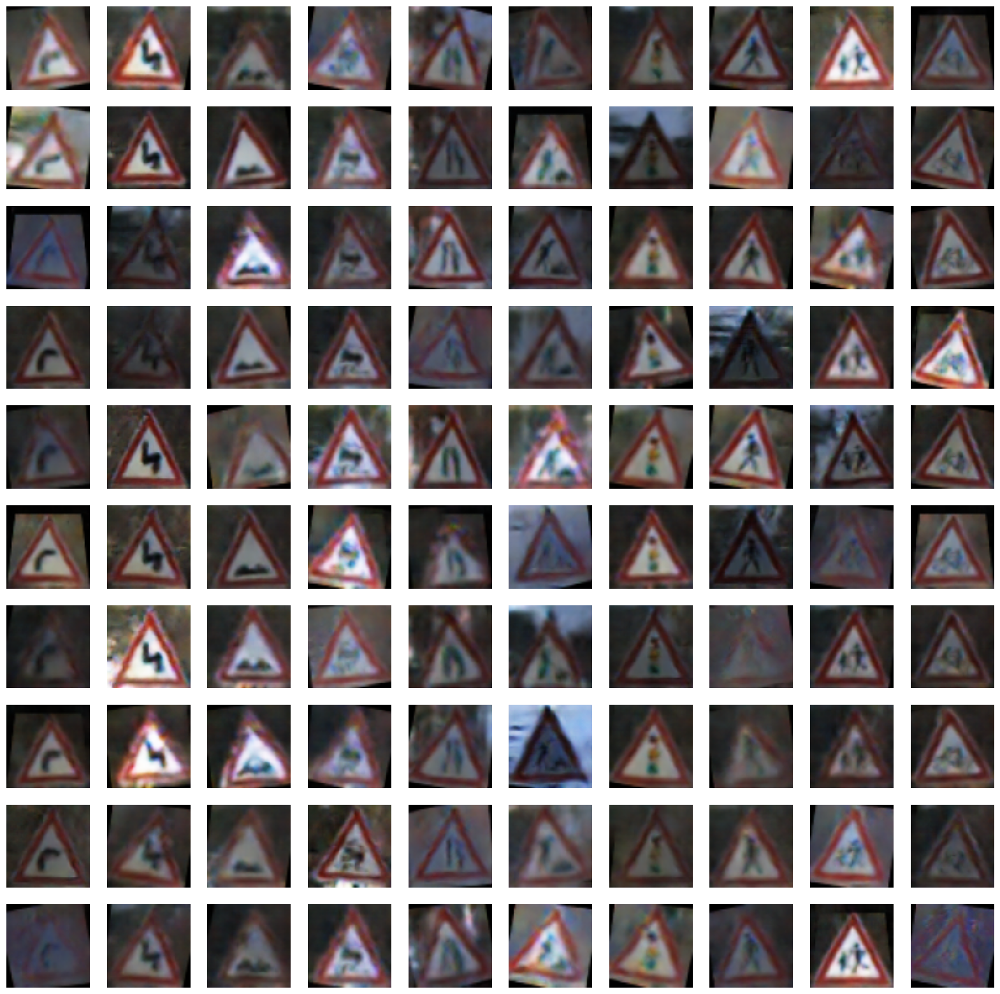

In [28]:
showResult('weights/traffic_signs_64_80epochs.h5', 20)

4/4 [==============================] - 0s 64ms/step


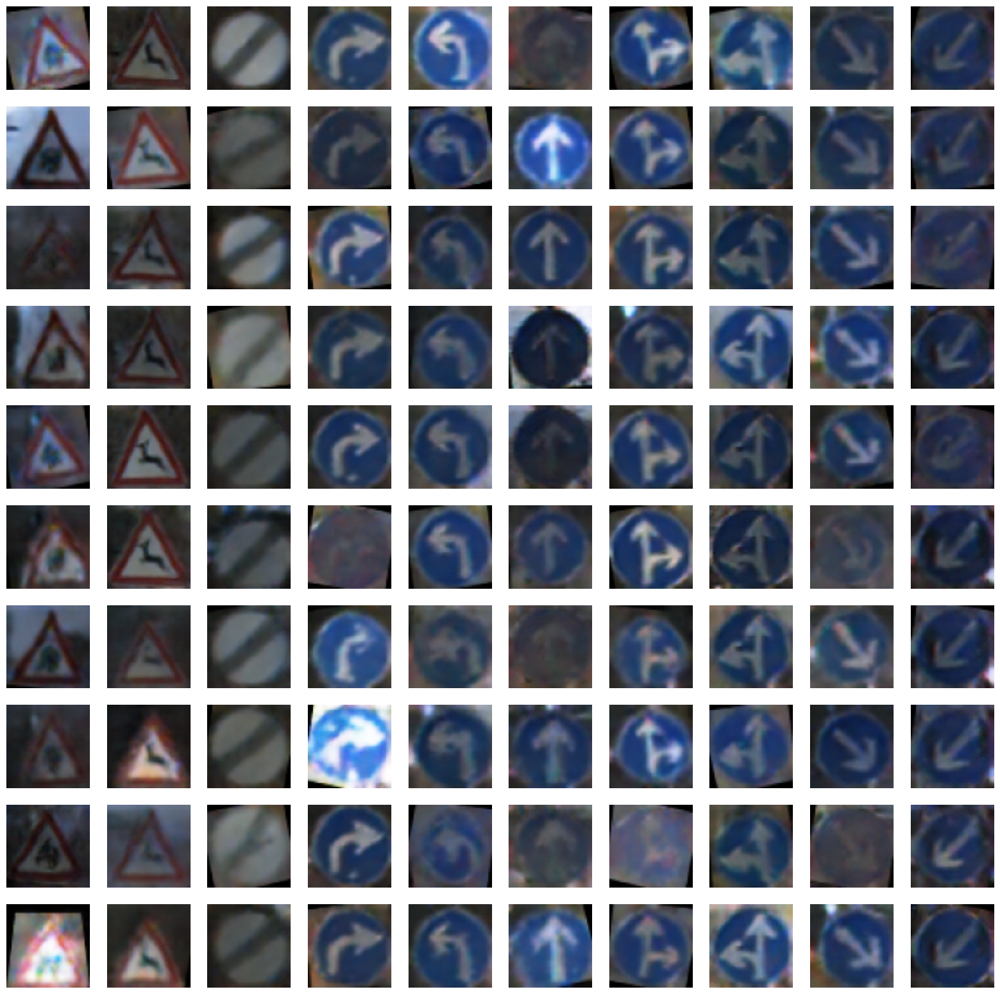

In [29]:
showResult('weights/traffic_signs_64_80epochs.h5', 30)

4/4 [==============================] - 0s 42ms/step


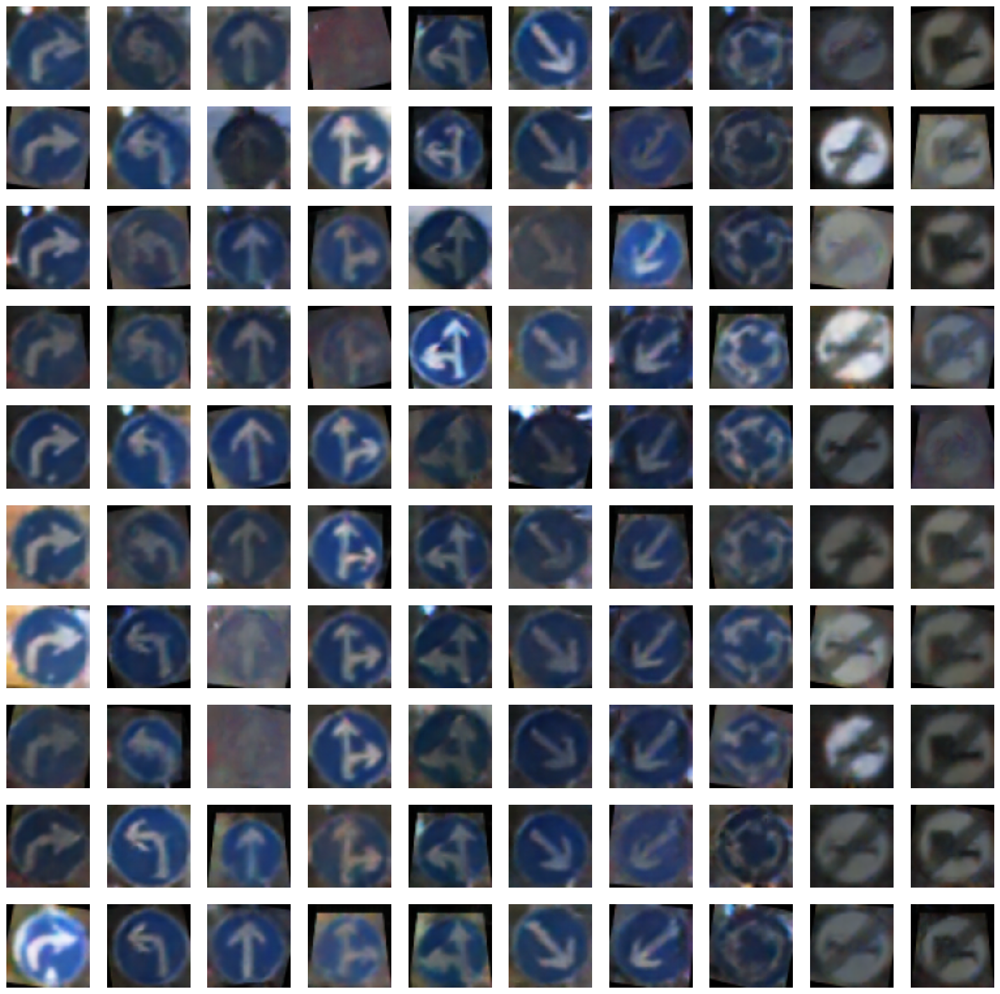

In [30]:
showResult('weights/traffic_signs_64_80epochs.h5', 33)